#Bank Churner prediction

##DataSet Review

1. Task Details: To predict the customers who are churned or not churned using method of classification based on the customer_churn(existing means 0/ attrited means 1). 

    ***The meaning of attrition customer is the result of clients and customers terminating their relationship with a brand.

2. Target: customer_churn: if Existing (not churn) means 0 and Attritied (churn) means 1.

3. Data Contain: The dataset of BankChurner consists of 23 columns and 10127 rows in total.
 
4. There are total 16.1% of churn customer and 83.9% of not churn customer,  which means the dataset is imbalance. The probability threshold adjustment shall apply to solve the imbalance dataset.





In [23]:
!pip3 install pandas_profiling
!pip3 install pycaret
!pip3 install shap

In [24]:
from google.colab import drive
drive.mount('/content/drive', force_remount = True)

Mounted at /content/drive


In [25]:
#For Google Colab only
from pycaret.utils import enable_colab 
enable_colab()

Colab mode enabled.


In [26]:
# import the necessary packages
import os
import pandas as pd
import numpy as np

%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
from pandas.plotting import register_matplotlib_converters
import seaborn as sns

In [27]:
# read the data into pandas
#'/content/drive/My Drive/cda_data/Block 3'
data_path = '/content/drive/My Drive/DataAnalyst/CDA_Project/creaditCardChunked'

df= pd.read_csv(os.path.join(data_path, 'BankChurners.csv'), header=None)
df.head(3)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Cat...,Naive_Bayes_Classifier_Attrition_Flag_Card_Cat...
1,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691,777,11914,1.335,1144,42,1.625,0.061,9.3448e-05,0.99991
2,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256,864,7392,1.541,1291,33,3.714,0.105,5.6861e-05,0.99994


#Data processing

1. Perform drop useless columns for last 2 columns including: Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,        Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
        

2. Convert the columns name to standalize format, which is lowercase.

3. Rename the columns name of attrition_flag to customer_churn.

4. Convert customer_churn to 1/0 for classification prediction. 



5. Convert columns from object to int/float including: 
    
    customer_age

    dependent_count

    months_on_book 

    total_relationship_count

    months_inactive_12_mon

    contacts_count_12_mon 

    credit_limit, total_revolving_bal

    avg_open_to_buy 

    total_amt_chng_q4_q1 

    total_trans_amt, total_trans_ct 

    total_ct_chng_q4_q1 
    
    avg_utilization_ratio


 



In [28]:
#Move row 1 to header and drop row 1 as the header is located at row 01.

df= df.rename(columns=df.iloc[0])

df = df.drop(df.index[0])
df.reset_index(drop=True)

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691,777,11914,1.335,1144,42,1.625,0.061,9.3448e-05,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256,864,7392,1.541,1291,33,3.714,0.105,5.6861e-05,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418,0,3418,2.594,1887,20,2.333,0,2.1081e-05,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313,2517,796,1.405,1171,20,2.333,0.76,0.00013366,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716,0,4716,2.175,816,28,2.5,0,2.1676e-05,0.99998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003,1851,2152,0.703,15476,117,0.857,0.462,0.00019143,0.99981
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277,2186,2091,0.804,8764,69,0.683,0.511,0.99527,0.00472896
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409,0,5409,0.819,10291,60,0.818,0,0.99788,0.00211827
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281,0,5281,0.535,8395,62,0.722,0,0.99671,0.00329379


In [29]:
#Drop 2 columns since not much useful for prediction.
df = df.drop(['Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1', 
                'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
             axis = 1).reset_index()

In [30]:
#check the type of columns.
df.dtypes

index                        int64
CLIENTNUM                   object
Attrition_Flag              object
Customer_Age                object
Gender                      object
Dependent_count             object
Education_Level             object
Marital_Status              object
Income_Category             object
Card_Category               object
Months_on_book              object
Total_Relationship_Count    object
Months_Inactive_12_mon      object
Contacts_Count_12_mon       object
Credit_Limit                object
Total_Revolving_Bal         object
Avg_Open_To_Buy             object
Total_Amt_Chng_Q4_Q1        object
Total_Trans_Amt             object
Total_Trans_Ct              object
Total_Ct_Chng_Q4_Q1         object
Avg_Utilization_Ratio       object
dtype: object

In [31]:
#check null values in each columns.
df.isnull().sum()

index                       0
CLIENTNUM                   0
Attrition_Flag              0
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64

In [32]:
#change all columns name to lower case.
df.columns = [c.lower() for c in df.columns]
df.columns

Index(['index', 'clientnum', 'attrition_flag', 'customer_age', 'gender',
       'dependent_count', 'education_level', 'marital_status',
       'income_category', 'card_category', 'months_on_book',
       'total_relationship_count', 'months_inactive_12_mon',
       'contacts_count_12_mon', 'credit_limit', 'total_revolving_bal',
       'avg_open_to_buy', 'total_amt_chng_q4_q1', 'total_trans_amt',
       'total_trans_ct', 'total_ct_chng_q4_q1', 'avg_utilization_ratio'],
      dtype='object')

In [33]:
#rename attrition_flag to customer_churn to make others understand easily.
df.rename(columns={'attrition_flag':'customer_churn'}, inplace=True)

In [34]:
#convert customer_churn to 1/0.
def convertion(x):
    if x == 'Attrited Customer':
        return 1
    elif x == 'Existing Customer':
        return 0

df.customer_churn = df.customer_churn.apply(convertion)

In [35]:
#Convert the columns from string to integer/float. 
#integer
df.clientnum = df.clientnum.astype('int')
df.customer_age = df.customer_age.astype('int')
df.dependent_count = df.dependent_count.astype('int')
df.months_on_book = df.months_on_book.astype('int')
df.total_relationship_count = df.total_relationship_count.astype('int')
df.months_inactive_12_mon = df.months_inactive_12_mon.astype('int')
df.contacts_count_12_mon = df.contacts_count_12_mon.astype('int')
df.total_revolving_bal = df.total_revolving_bal.astype('int')
df.total_trans_amt = df.total_trans_amt.astype('int')
df.total_trans_ct = df.total_trans_ct.astype('int')

#float
df.total_amt_chng_q4_q1 = df.total_amt_chng_q4_q1.astype('float')
df.total_ct_chng_q4_q1 = df.total_ct_chng_q4_q1.astype('float')
df.avg_utilization_ratio = df.avg_utilization_ratio.astype('float')
df.credit_limit = df.credit_limit.astype('float')
df.avg_open_to_buy = df.avg_open_to_buy.astype('float')



In [36]:
#check the type and details after perform type convertion.
print(df.dtypes)
print(df.head(3))

index                         int64
clientnum                     int64
customer_churn                int64
customer_age                  int64
gender                       object
dependent_count               int64
education_level              object
marital_status               object
income_category              object
card_category                object
months_on_book                int64
total_relationship_count      int64
months_inactive_12_mon        int64
contacts_count_12_mon         int64
credit_limit                float64
total_revolving_bal           int64
avg_open_to_buy             float64
total_amt_chng_q4_q1        float64
total_trans_amt               int64
total_trans_ct                int64
total_ct_chng_q4_q1         float64
avg_utilization_ratio       float64
dtype: object
   index  clientnum  ...  total_ct_chng_q4_q1  avg_utilization_ratio
0      1  768805383  ...                1.625                  0.061
1      2  818770008  ...                3.714           

In [69]:
from pandas_profiling import ProfileReport

# run profile report
df.profile_report(explorative=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [37]:
# use pandas to munge data
# get list of columns that are numerical
num_vars = df.describe().columns

# get dataset of categorical columns
cat_vars = [c for c in df.columns if c not in num_vars]

print(num_vars)
print(cat_vars)

Index(['index', 'clientnum', 'customer_churn', 'customer_age',
       'dependent_count', 'months_on_book', 'total_relationship_count',
       'months_inactive_12_mon', 'contacts_count_12_mon', 'credit_limit',
       'total_revolving_bal', 'avg_open_to_buy', 'total_amt_chng_q4_q1',
       'total_trans_amt', 'total_trans_ct', 'total_ct_chng_q4_q1',
       'avg_utilization_ratio'],
      dtype='object')
['gender', 'education_level', 'marital_status', 'income_category', 'card_category']


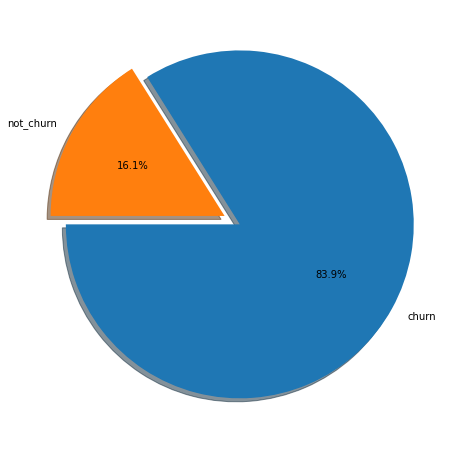

In [45]:
#The pie chart shows that percentage of churn rate is imbalance.
def churnRate():
    churn = df.customer_churn[df['customer_churn']==0].count()
    not_churn = df.customer_churn[df['customer_churn']==1].count()

    churn_list = [churn, not_churn]
    labels = ['churn', 'not_churn']
    explode = (0, 0.1)

    fig1, ax1 = plt.subplots(figsize=(10, 8))
    ax1.pie(churn_list, explode=explode, labels=labels, autopct='%1.1f%%'
    ,shadow=True, startangle = 180)
    plt.show() 
churnRate()


#Setup the model without pre-processing

setup the model without any pre-processing.

default model without any normalization

In [44]:
from pycaret.classification import *

In [46]:
# setup the model without any pre-processing.
# default model without any normalization
model = setup(
    data=df,
    target='customer_churn', 
    categorical_features=cat_vars, 
    ignore_features=['clientnum']  
)

,Description,Value
0,session_id,6475
1,Target,customer_churn
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(10127, 22)"
5,Missing Values,False
6,Numeric Features,11
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


In [47]:
# check the training set
get_config('X_train')

,customer_age,months_on_book,total_revolving_bal,avg_open_to_buy,total_amt_chng_q4_q1,total_trans_amt,total_trans_ct,total_ct_chng_q4_q1,avg_utilization_ratio,gender_F,dependent_count_0,dependent_count_1,dependent_count_2,dependent_count_3,dependent_count_4,dependent_count_5,education_level_College,education_level_Doctorate,education_level_Graduate,education_level_High School,education_level_Post-Graduate,education_level_Uneducated,education_level_Unknown,marital_status_Divorced,marital_status_Married,marital_status_Single,marital_status_Unknown,income_category_$120K +,income_category_$40K - $60K,income_category_$60K - $80K,income_category_$80K - $120K,income_category_Less than $40K,income_category_Unknown,card_category_Blue,card_category_Gold,card_category_Platinum,card_category_Silver,total_relationship_count_1,total_relationship_count_2,total_relationship_count_3,total_relationship_count_4,total_relationship_count_5,total_relationship_count_6,months_inactive_12_mon_0,months_inactive_12_mon_1,months_inactive_12_mon_2,months_inactive_12_mon_3,months_inactive_12_mon_4,months_inactive_12_mon_5,months_inactive_12_mon_6,contacts_count_12_mon_0,contacts_count_12_mon_1,contacts_count_12_mon_2,contacts_count_12_mon_3,contacts_count_12_mon_4,contacts_count_12_mon_5,contacts_count_12_mon_6
3512,52.0,40.0,1721.0,538.0,0.682,1852.0,38.0,0.810,0.762,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1781,29.0,19.0,0.0,2926.0,0.840,2775.0,74.0,1.114,0.000,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
9870,44.0,31.0,1687.0,1785.0,0.645,13999.0,119.0,0.725,0.486,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
8140,51.0,36.0,1506.0,82.0,0.615,4660.0,68.0,0.619,0.948,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
6926,39.0,33.0,0.0,2255.0,0.730,4412.0,81.0,0.884,0.000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9760,32.0,26.0,1130.0,5277.0,0.756,14471.0,93.0,0.603,0.176,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
9357,48.0,36.0,1320.0,20206.0,0.762,14441.0,105.0,0.875,0.061,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5135,55.0,47.0,1689.0,998.0,0.714,2370.0,34.0,0.789,0.629,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
9644,53.0,36.0,2088.0,32428.0,0.822,15290.0,123.0,0.732,0.060,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [48]:
# list all the available models
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


In [49]:
#try compare the model for F1 viewing.
compare_models(sort='F1')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9728,0.9925,0.8928,0.9338,0.9126,0.8965,0.8970,0.189
gbc,Gradient Boosting Classifier,0.9646,0.9880,0.8370,0.9346,0.8827,0.8619,0.8640,1.238
ada,Ada Boost Classifier,0.9577,0.9845,0.8326,0.8952,0.8622,0.8373,0.8384,0.343
rf,Random Forest Classifier,0.9494,0.9836,0.7449,0.9232,0.8238,0.7947,0.8014,0.871
dt,Decision Tree Classifier,0.9331,0.8734,0.7857,0.7945,0.7891,0.7494,0.7501,0.065
lda,Linear Discriminant Analysis,0.9127,0.9314,0.6280,0.7817,0.6963,0.6460,0.6514,0.062
nb,Naive Bayes,0.9003,0.8873,0.6457,0.7043,0.6732,0.6145,0.6157,0.027
et,Extra Trees Classifier,0.9169,0.9636,0.5244,0.9191,0.6675,0.6241,0.6564,0.784
lr,Logistic Regression,0.9001,0.9151,0.5501,0.7575,0.6365,0.5804,0.5908,0.403
knn,K Neighbors Classifier,0.8915,0.8748,0.5607,0.6995,0.6219,0.5595,0.5645,0.157


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=6475, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

#Pre-processing 

try with z-score normalization

z-score normalization is similar to StandardScaler in sklearn

In [50]:
# try with z-score normalization
# z-score normalization is similar to StandardScaler in sklearn
model = setup(
    data=df,
    target='customer_churn',
    categorical_features=cat_vars, 
    ignore_features=['clientnum'],

    normalize=True, #pre-processing
    normalize_method='zscore',  #pre-processing
)

,Description,Value
0,session_id,2706
1,Target,customer_churn
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(10127, 22)"
5,Missing Values,False
6,Numeric Features,11
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


In [51]:
#compare the model before create model
compare_models(sort='F1')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9707,0.9932,0.8856,0.9305,0.9069,0.8895,0.8903,0.178
gbc,Gradient Boosting Classifier,0.9632,0.9882,0.8297,0.9358,0.8787,0.8571,0.8598,1.243
ada,Ada Boost Classifier,0.9571,0.9843,0.8410,0.8879,0.8633,0.8379,0.8387,0.341
rf,Random Forest Classifier,0.9482,0.9850,0.7388,0.9261,0.8211,0.7913,0.7987,0.880
dt,Decision Tree Classifier,0.9345,0.8803,0.8001,0.7962,0.7972,0.7582,0.7588,0.063
lda,Linear Discriminant Analysis,0.9145,0.9306,0.6375,0.7951,0.7068,0.6575,0.6635,0.062
lr,Logistic Regression,0.9124,0.9330,0.6236,0.7924,0.6969,0.6466,0.6535,0.104
svm,SVM - Linear Kernel,0.9012,0.0000,0.6435,0.7338,0.6772,0.6198,0.6268,0.053
et,Extra Trees Classifier,0.9168,0.9617,0.5267,0.9284,0.6708,0.6274,0.6611,0.796
knn,K Neighbors Classifier,0.9056,0.8995,0.5581,0.7973,0.6556,0.6030,0.6164,0.592


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=2706, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [52]:
#create best model from above
best_model = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9704,0.9904,0.8509,0.9604,0.9023,0.8849,0.8872
1,0.9676,0.9939,0.8596,0.9333,0.8950,0.8758,0.8769
2,0.9704,0.9930,0.8684,0.9429,0.9041,0.8866,0.8877
3,0.9704,0.9962,0.8870,0.9273,0.9067,0.8891,0.8894
4,0.9690,0.9932,0.8522,0.9515,0.8991,0.8808,0.8827
5,0.9690,0.9899,0.8696,0.9346,0.9009,0.8825,0.8833
6,0.9774,0.9965,0.9391,0.9231,0.9310,0.9175,0.9176
7,0.9577,0.9910,0.8783,0.8632,0.8707,0.8454,0.8454
8,0.9760,0.9933,0.9386,0.9145,0.9264,0.9121,0.9122
9,0.9788,0.9947,0.9123,0.9541,0.9327,0.9202,0.9205


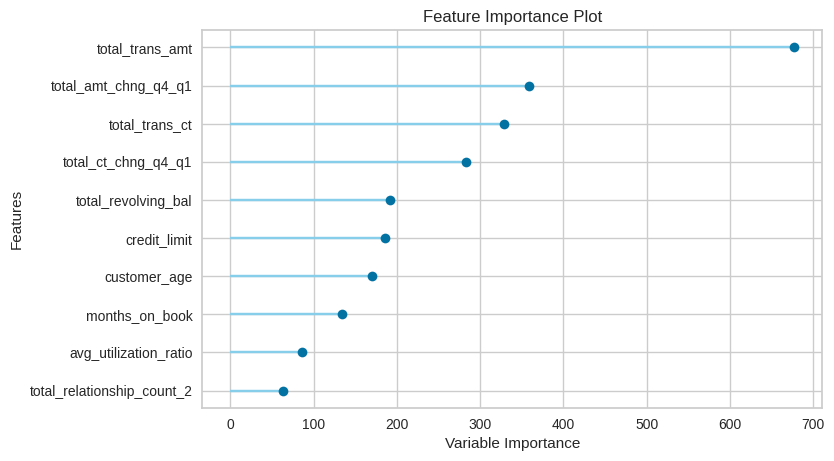

In [53]:
# plot the model with parameter = feature
plot_model(best_model, plot='feature') 

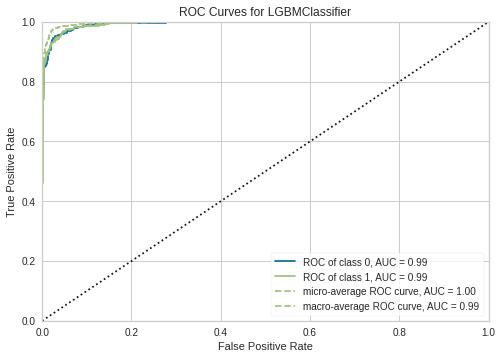

In [54]:
#plot ROC-AUC chart.
plot_model(best_model)

In [55]:
#plot confusion matrix.
evaluate_model(best_model)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

#Tune model

Tune model to get best F1, the mean of lr_tuned is slighly higher than best_model. 

Thus, decided to use the lr_tuned.

In [56]:
params = {'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
          'max_iter': [10, 100, 1000], #max number of iteration
          }

lr_tuned = tune_model(best_model,
           n_iter=50,
           optimize='F1',
           custom_grid=params
           )

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9676,0.9915,0.8509,0.9417,0.8940,0.8749,0.8765
1,0.9690,0.9934,0.8684,0.9340,0.9000,0.8817,0.8825
2,0.9676,0.9931,0.8772,0.9174,0.8969,0.8776,0.8779
3,0.9746,0.9968,0.9043,0.9369,0.9204,0.9053,0.9055
4,0.9704,0.9939,0.8783,0.9352,0.9058,0.8883,0.8889
5,0.9704,0.9903,0.8609,0.9519,0.9041,0.8866,0.8882
6,0.9788,0.9962,0.9478,0.9237,0.9356,0.9230,0.9231
7,0.9661,0.9916,0.8870,0.9027,0.8947,0.8746,0.8746
8,0.9703,0.9932,0.9211,0.8974,0.9091,0.8914,0.8915
9,0.9802,0.9959,0.9298,0.9464,0.9381,0.9263,0.9263


#Explain the model

Feature importance (variable importance) refer to the most relevant features with highest scores that computed via various supervised technique such as Random Forest, Adaboost and correlation measurement with target variable to improve the efficiency and accuracy of prediction model. 

At below, there are 10 most important feature that sorted by highest scores for prediction, which is:
    
    1. total_trans_amt
    2. total_amt_chng_q4_q1 #Change in amount of transaction for Q4 over Q1
    3. total_trans_ct #Number of transaction in count.
    4. total_ct_chng_q4_q1 #Change in count of transaction for Q4 over Q1
    5. avg_open_to_buy #The amount difference within current balance in account and credit limit in cardholder account with average of past 12 months. 
    6. total_revolving_bal #Amount that carries over to next month in credit card
    7. customer_age 
    8. months_on_book #How long the customer interact with bank
    9. avg_utilization_ration #Card utilization ratio in average
    10. marital_Married







##Top 3 features explanation

Based on the graph at below, we can see the total transaction amount, total amount change for Q4 over Q1 & total transaction count having higher impact on customer intend to churn. The bank shall start to implement some solution such as online survey or analysis the data to understand better regarding why customer likely to churn. This reason could be loan interest rate not much attractive or credit card restriction too tight for customer. 

The customer age also huge impact on customer intend to churn, mostly the age group between 40 to 50 will likely to churn. The bank should exam the root cause of churn for this group of customer. Maybe they suffer in family commitment, so they intend to change other bank. 

The promotion shall implement including to attract customer to stay with bank:
1. Up to one handred cashback with at least one trasaction.
2. An Apple watch to customer who spend with a mininum of three hundred. 
3. Two hundred e-voucher with a mininum spend of $300 and etc.  

The bar chart at below showing the trend of churn on group of age. Most likely age group between 40 to 50 intend to churn. 









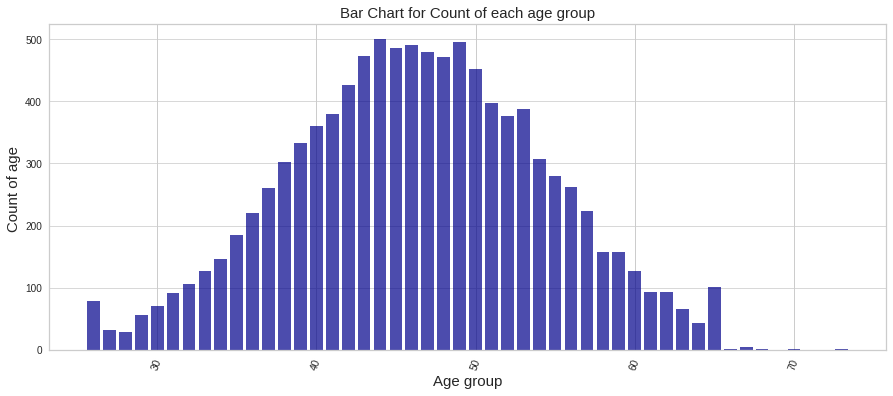

In [57]:
#As observation, the age between 40 to 50 are likely to churn.
def drawAge():
    age = df.groupby(df['customer_age'])['customer_age'].count().reset_index(name = 'Total')
    age01 = age.values.tolist()

    #print(age01)

    dfplot = pd.DataFrame(age01, columns = ['customer_age', 'Total'])
    #print(dfplot)

    #Display the results in histogram based on dfplot dataframe.
    dfplotHis = plt.figure(figsize=(15,6))
    dfplotAxes = dfplotHis.add_subplot(1,1,1)
    dfplotAxes.bar(dfplot['customer_age'],dfplot['Total'], color= '#00008B', alpha=0.7)
    dfplotAxes.grid(axis='y', alpha=0.75)
    dfplotAxes.set_title('Bar Chart for Count of each age group', fontsize=15)
    dfplotAxes.set_xlabel('Age group', fontsize=15)
    dfplotAxes.set_ylabel('Count of age ', fontsize=15)
    plt.xticks(rotation=70) #rotate the word for x axis.

    plt.show()  
drawAge()



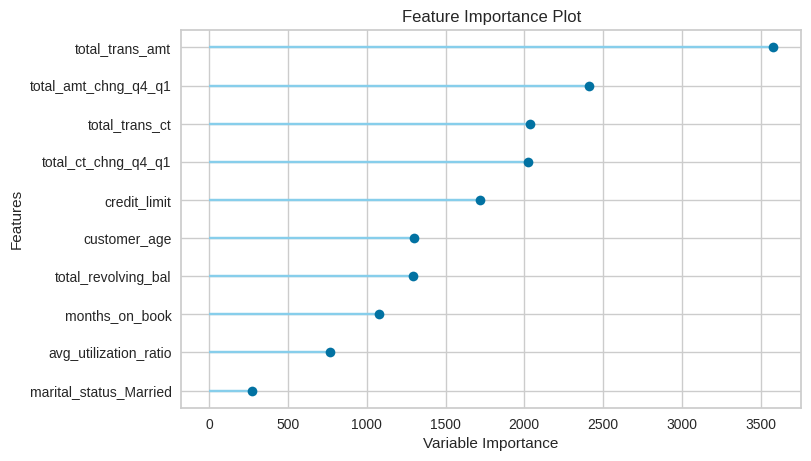

In [58]:
# plot the model with parameter = feature
plot_model(lr_tuned, plot='feature') 

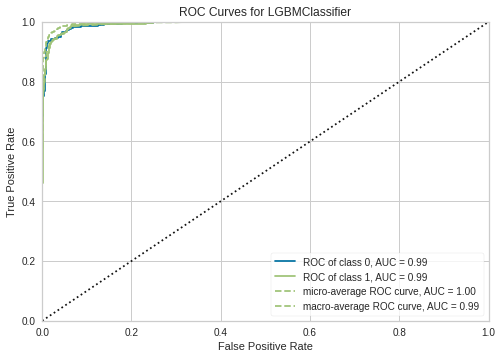

In [59]:
#plot ROC-AUC chart.
plot_model(lr_tuned)

#Explaination of confusion matrix

True positive (TP): Means the cases in which predicted yes and customer is churn. How often the predicted is yes.

True Negative (TN): Means the cases in which predicted no and customer is not churn. How often the predicted is No.

False negative (FN): Means the predicted no but actually the customer is churn. 

False positive (FP): Means the predicted yes but actually the customer is not churn. 

##Recall Or Precision?

Precision is refer to the correctly positive cases out of all predicted as positive, which is how precise of actual positive when it predicts as positive. 
For instance, out of 10 customer predicted as churn by the model, how many customer are correct churn. 

Recall is refer to the number of true positives cases out of all positives in dataset, which is how often predicted correctly as positive. 
For instance, out of 10 churn customer in the data, how many customer classified correctly as churn customer. 

As observation at above, we shall using recall for confusion matrix measurement. This reason is we wish to find out how many customers are correctly predicted as churn from 10127 rows in this dataset.  


In [60]:
#plot confusion matrix chart.
#True=1, Predicted =1, which means True positive.
#True=0, Predicted =0, which means True negative.
#True=1, Predicted =0, which means False negative type 2 error.
#True=0, Predicted =1, which means False positive type 1 error.

evaluate_model(lr_tuned)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [61]:
# saving the model will save it to the runtime environment
save_model(lr_tuned, model_name='bank_churner_train_01')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=['gender',
                                                             'education_level',
                                                             'marital_status',
                                                             'income_category',
                                                             'card_category'],
                                       display_types=True,
                                       features_todrop=['clientnum'],
                                       id_columns=['index'],
                                       ml_usecase='classification',
                                       numerical_features=[],
                                       target='customer_churn',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(c...
                                 class_weight=None

#Prediction for the model



In [62]:
#load saved trained model
best_model = load_model('bank_churner_train_01')

Transformation Pipeline and Model Successfully Loaded


##Try retrieved sample of data for existing customer and test the prediction score.

In [63]:
#check the columns and use for sample of user request.
print(df.columns)
df.iloc[0] #for customer_churn: existing customer (0)

Index(['index', 'clientnum', 'customer_churn', 'customer_age', 'gender',
       'dependent_count', 'education_level', 'marital_status',
       'income_category', 'card_category', 'months_on_book',
       'total_relationship_count', 'months_inactive_12_mon',
       'contacts_count_12_mon', 'credit_limit', 'total_revolving_bal',
       'avg_open_to_buy', 'total_amt_chng_q4_q1', 'total_trans_amt',
       'total_trans_ct', 'total_ct_chng_q4_q1', 'avg_utilization_ratio'],
      dtype='object')


index                                 1
clientnum                     768805383
customer_churn                        0
customer_age                         45
gender                                M
dependent_count                       3
education_level             High School
marital_status                  Married
income_category             $60K - $80K
card_category                      Blue
months_on_book                       39
total_relationship_count              5
months_inactive_12_mon                1
contacts_count_12_mon                 3
credit_limit                      12691
total_revolving_bal                 777
avg_open_to_buy                   11914
total_amt_chng_q4_q1              1.335
total_trans_amt                    1144
total_trans_ct                       42
total_ct_chng_q4_q1               1.625
avg_utilization_ratio             0.061
Name: 0, dtype: object

In [64]:
#Example of a user request and how the model predict the existing customer (0)
user_request = [{
    'customer_age': 30, 
    'gender': 'M',
    'dependent_count': 4, 
    'education_level': 'High_School', 
    'marital_status': 'Single',
    'income_category': '$60K - $80K',
    'card_category': 'Blue', 
    'months_on_book': 30,
    'total_relationship_count': 4, 
    'months_inactive_12_mon': 1,
    'contacts_count_12_mon': 4, 
    'credit_limit': 30000, 
    'total_revolving_bal': 800,
    'avg_open_to_buy': 29000, 
    'total_amt_chng_q4_q1': 1.345, 
    'total_trans_amt': 350, #1000
    'total_trans_ct': 40, 
    'total_ct_chng_q4_q1': 1.525, 
    'avg_utilization_ratio': 0.051
}]

user_request = pd.DataFrame(user_request)
user_request

,customer_age,gender,dependent_count,education_level,marital_status,income_category,card_category,months_on_book,total_relationship_count,months_inactive_12_mon,contacts_count_12_mon,credit_limit,total_revolving_bal,avg_open_to_buy,total_amt_chng_q4_q1,total_trans_amt,total_trans_ct,total_ct_chng_q4_q1,avg_utilization_ratio
0,30,M,4,High_School,Single,$60K - $80K,Blue,30,4,1,4,30000,800,29000,1.345,350,40,1.525,0.051


In [65]:
#Start to perform prediction for existing customer.
predict_model(best_model, user_request)

,customer_age,gender,dependent_count,education_level,marital_status,income_category,card_category,months_on_book,total_relationship_count,months_inactive_12_mon,contacts_count_12_mon,credit_limit,total_revolving_bal,avg_open_to_buy,total_amt_chng_q4_q1,total_trans_amt,total_trans_ct,total_ct_chng_q4_q1,avg_utilization_ratio,Label,Score
0,30,M,4,High_School,Single,$60K - $80K,Blue,30,4,1,4,30000,800,29000,1.345,350,40,1.525,0.051,0,0.9998


##Try retrieved sample of data for attrition customer and test the prediction score.

In [66]:
 df.iloc[21] #for customer_churn: attrited customer (1)

index                                   22
clientnum                        708508758
customer_churn                           1
customer_age                            62
gender                                   F
dependent_count                          0
education_level                   Graduate
marital_status                     Married
income_category             Less than $40K
card_category                         Blue
months_on_book                          49
total_relationship_count                 2
months_inactive_12_mon                   3
contacts_count_12_mon                    3
credit_limit                        1438.3
total_revolving_bal                      0
avg_open_to_buy                     1438.3
total_amt_chng_q4_q1                 1.047
total_trans_amt                        692
total_trans_ct                          16
total_ct_chng_q4_q1                    0.6
avg_utilization_ratio                    0
Name: 21, dtype: object

In [67]:
#Example of a user request and how the model predict the attrited customer (1)
user_request01 = [{
    'customer_age': 60, 
    'gender': 'M',
    'dependent_count': 0, 
    'education_level': 'High_School', 
    'marital_status': 'Single',
    'income_category': 'Less than $40K',
    'card_category': 'Blue', 
    'months_on_book': 35,
    'total_relationship_count': 2, 
    'months_inactive_12_mon': 1,
    'contacts_count_12_mon': 4, 
    'credit_limit': 1500, 
    'total_revolving_bal': 10,
    'avg_open_to_buy': 1500, 
    'total_amt_chng_q4_q1': 1.045, 
    'total_trans_amt': 1000, #700
    'total_trans_ct': 13, 
    'total_ct_chng_q4_q1': 0.525, 
    'avg_utilization_ratio': 0
}]

user_request01 = pd.DataFrame(user_request01)
user_request01

,customer_age,gender,dependent_count,education_level,marital_status,income_category,card_category,months_on_book,total_relationship_count,months_inactive_12_mon,contacts_count_12_mon,credit_limit,total_revolving_bal,avg_open_to_buy,total_amt_chng_q4_q1,total_trans_amt,total_trans_ct,total_ct_chng_q4_q1,avg_utilization_ratio
0,60,M,0,High_School,Single,Less than $40K,Blue,35,2,1,4,1500,10,1500,1.045,1000,13,0.525,0


In [68]:
#Start to perform prediction for existing customer.
predict_model(best_model, user_request01)

,customer_age,gender,dependent_count,education_level,marital_status,income_category,card_category,months_on_book,total_relationship_count,months_inactive_12_mon,contacts_count_12_mon,credit_limit,total_revolving_bal,avg_open_to_buy,total_amt_chng_q4_q1,total_trans_amt,total_trans_ct,total_ct_chng_q4_q1,avg_utilization_ratio,Label,Score
0,60,M,0,High_School,Single,Less than $40K,Blue,35,2,1,4,1500,10,1500,1.045,1000,13,0.525,0,1,0.9999
